# GraphSAGE

## Introduction

A GraphSAGE net is built up of k convolutional layers, called SageConv layers by the authors. Like other GNNs, they use a message-passing algorithm to combine neighbourhood features for each node. These features are then aggregated using a reduce function like max pool or mean.

## Setup

In [2]:
import numpy as np
import networkx as nx

from IPython.display import HTML
import matplotlib.animation as animation
import matplotlib.pyplot as plt

import dgl
import time

import torch
import torch.nn as nn
import torch.nn.functional as F

Using backend: pytorch


## Datasets

In [3]:
# To demonstrate let's use the Cora dataset
# DGL provides an api to access this and other dataset.
from dgl.data import citation_graph
data = citation_graph.CoraDataset()

There are 2708 nodes and 10556 edges
Each node has 1433 features
There are 7 classes


(array([298., 418., 818., 426., 217., 180., 351.]),
 array([0.        , 0.85714286, 1.71428571, 2.57142857, 3.42857143,
        4.28571429, 5.14285714, 6.        ]),
 <a list of 7 Patch objects>)

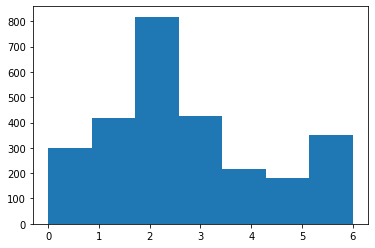

In [4]:
features = data.features
# that will download and cache the data for use later
# let's investigate
n_features = int(features.shape[1])
n_nodes = int(features.shape[0])
n_edges = data.graph.number_of_edges()

print(f'There are {n_nodes} nodes and {n_edges} edges')
print(f'Each node has {n_features} features')

# let's look at the labels, the classification target
labels = data.labels
n_classes = labels.max() + 1
print("There are {} classes".format(n_classes))
plt.hist(labels.flatten()[:20000], bins=n_classes)

In [5]:
# DGL datasets come preprepared with train/test/val splits, in the form of index masks
train_mask = data.train_mask
val_mask = data.val_mask
test_mask = data.test_mask
print(int(train_mask.sum()), 'train samples')
print(int(val_mask.sum()), 'validation samples')
print(int(test_mask.sum()), 'test samples')

140 train samples
300 validation samples
1000 test samples


In [6]:
# Let's convert the data from numpy arrays to the required pytorch tensors. 
features = torch.FloatTensor(features)
labels = torch.LongTensor(labels)
train_mask = torch.BoolTensor(train_mask)
val_mask = torch.BoolTensor(val_mask)
test_mask = torch.BoolTensor(test_mask)

In [7]:
# If we are using the gpu, we can send the arrays to gpu memory.
gpu = 0
if gpu >= 0:
    torch.cuda.set_device(gpu)
    features = features.cuda()
    labels = labels.cuda()
    train_mask = train_mask.cuda()
    val_mask = val_mask.cuda()
    test_mask = test_mask.cuda()   

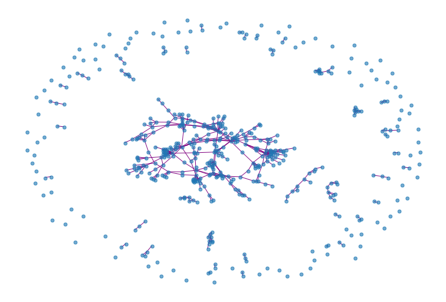

In [8]:
# DGL datasets come with a pre-initialised networkx graph
g = data.graph
# first remove any existing self-loops, because graphSAGE employs
# its own way of dealing with self-loops in the forward pass
g.remove_edges_from(nx.selfloop_edges(g))
# and lets recalc the num of edges for later
n_edges = g.number_of_edges()
# for simplicity lets convert the graph to an undirected one
g = g.to_undirected()

# with a networkx graph we can do some plotting
# lets just plot a fraction of the nodes
g_copy = g.copy()
g_copy.remove_nodes_from(range(500, n_nodes))
nx.draw(g_copy, node_size=10, alpha=0.6, arrows=False, edge_color='purple')

In [9]:
# We can build a trainable GNN out of this networkx graph with dgl/
# The DGLGraph can take a networkx graph as input
g = dgl.DGLGraph(g)

## Architecture

Let's create a simple SageConv layer in dgl / pytorch using a 'mean' aggregator.

In [10]:
# Like all layers and neural nets in pytorch we will inherit the Module class
class MeanAggSageLayer(nn.Module):
    def __init__(self, n_features_in, n_features_out):
        super(MeanAggSageLayer, self).__init__()
        # number of features coming in to this layer. If this is the first layer, 
        # this will be the amount of features per node
        self._in = n_features_in
        # the number of output features from this layer,
        # In the final layer of the GraphSAGE net this will equal n_classes 
        self._out = n_features_out
        # create a linear transformation between the input channels and the output.
        # These nn.Linear objects are shortcuts to hold the weights and biases
        # that are learnt through backpropogation, and applied
        # to incoming features. We will have one for self nodes 
        self.fc_self = nn.Linear(self._in, self._out)
        # and one for neighbour nodes 
        self.fc_neigh = nn.Linear(self._in, self._out)
        # we will initialise the weights with xavier_unform random
        # sampling, another name for Glorot uniform used in the original
        # graphsage paper
        gain = nn.init.calculate_gain('relu')   # sqrt(2)
        # set the gain appropriately for our activation function 
        nn.init.xavier_uniform_(self.fc_self.weight, gain=gain)
        nn.init.xavier_uniform_(self.fc_neigh.weight, gain=gain)
    
    def forward(self, graph, features):
        """
        The following code is DGL's way of using the graph class
        to facilitate message passing. The equivalent code in pure pytorch
        operating instead on the adjacency matrix adj and the feature matrix x would be:
            
            def forward(self, x, adj):
                return adj.matmul(x, reduce='mean') @ self_weights + x @ neigh_weights + bias
        
        """
        # set the incoming features matrix as the input to this layer 'h'
        graph.srcdata['h'] = features
        # create 2 user defined functions, the first to collect features 
        # from the src nodes 'h', send along edges 'm', and aggregate them at the 
        # destination nodes (the neighbours)
        features_from_src_nodes = dgl.function.copy_src('h', 'm')
        aggregation_at_dst_nodes = dgl.function.mean('m', 'neigh')
        # graph.update_all is a helper function to send the first function
        # along the edges and recieve the second function at the
        # destination nodes
        graph.update_all(features_from_src_nodes, aggregation_at_dst_nodes)
        # now we can get our aggregated neighbourhood features
        h_neigh = graph.dstdata['neigh']
        # and combine them with the src features (self loops)
        # fc_self(features) is equivalent to features @ weights + biases
        output = self.fc_self(features) + self.fc_neigh(h_neigh)
        # lastly we add a nonlinearity to the output enabling backpropogation
        output = F.relu(output)
        return output
    

The only method we need will be the forward pass. The backpropogation will happen externally.

Now lets build a graphSAGE GNN out of these layers that takes in a DGLGraph we made previously

In [11]:
class SimpleGraphSAGE(nn.Module):
    def __init__(
            self, 
            g, 
            n_features, 
            n_hidden, 
            n_classes, 
            n_layers
    ):
        super(SimpleGraphSAGE, self).__init__()
        # A ModuleList will hold all of our layers
        self.conv_layers = nn.ModuleList()
        self.g = g

        # input layer, the input size of which will be 
        # the number of features
        self.conv_layers.append(MeanAggSageLayer(n_features, n_hidden))
        # create the hidden layers: (n_layers - 1) allowing for the output layer
        for i in range(n_layers - 1):
            self.conv_layers.append(MeanAggSageLayer(n_hidden, n_hidden))
        # output layer, the output size of which will be the number of classes
        self.conv_layers.append(MeanAggSageLayer(n_hidden, n_classes))

    def forward(self, features):
        # h(0) will be equal to the feature matrix
        h = features
        for conv in self.conv_layers:
            # pass h through one layer and back into the next
            h = conv(self.g, h)
        # now we have h(k)
        return h

Before we create one of these models we need to decide on some params:


In [13]:
n_hidden = 16
n_layers = 2
learning_rate = 0.01
weight_decay = 0.0005
n_epochs = 120

Now we can create a graphSAGE model using our graph (g)

In [14]:
model = SimpleGraphSAGE(g, n_features, n_hidden, n_classes, n_layers)
# we can send this to gpu memory as well
if gpu >= 0:
    model.cuda()

In [15]:
# use cross entropy loss function
loss_fcn = torch.nn.CrossEntropyLoss()

# use Adam Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate,
                             weight_decay=weight_decay)

In [16]:
# we also need a scoring function, lets create a simple accuracy calculator:
def get_accuracy(pred, true):
    _, indices = torch.max(pred, dim=1)
    correct = torch.sum(indices == true)
    return correct.item() * 1.0 / len(true)

In [17]:
# now our training pipeline is able to be built
def train(model, optimizer, n_epochs):
    # we will keep track how long each epoch takes so we can calculate things like
    # Traversed Edges Per Second (TEPS)
    dur = []
    all_train_logits = []

    for epoch in range(n_epochs):

        # This doesnt train the mdoel, instead it tells all the child modules
        # that the model is in training mode and not evaluating mode
        # (for examplee, when evaluating, you dont want to apply dropout to the input tensor)
        model.train()
        t0 = time.time()

        # the forward pass - sending the features to the model.forward method
        output = model(features)
        # calculate our current loss by comparing only the training nodes'
        # prediction and truth
        output_train = output[train_mask]
        loss = loss_fcn(output_train, labels[train_mask])

        # the backwards pass! update the weights in our SAGELayers - but first:
        # reset the gradient back to 0 before doing backpropogation
        # (pytorch by default accumulates the gradients after each backward pass)
        optimizer.zero_grad()
        # backpropogation
        loss.backward()
        # step the adam optimizer forward
        optimizer.step()

        dur.append(time.time() - t0)

        # set the model into evaluation model
        model.eval()
        # temporatily turn off the gradient calculation as
        # just want to simply inference
        with torch.no_grad():
            output_val = output[val_mask]
            labels_val = labels[val_mask]
            acc = get_accuracy(output_val, labels_val)

        # record the output logits for plotting later
        all_train_logits.append(output_train)

        print("Epoch {:05d} | Time(s) {:.4f} | Loss {:.4f} | Accuracy {:.4f} | "
              "TEPS {:.2f}".format(epoch, np.mean(dur), loss.item(), acc, 
                                   n_edges / np.mean(dur)))

    print('training complete')
    return model, output, all_train_logits


In [18]:
model, last_output, _ = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.7382 | Loss 1.9706 | Accuracy 0.1133 | TEPS 14300.42
Epoch 00001 | Time(s) 0.3720 | Loss 1.9177 | Accuracy 0.1133 | TEPS 28372.62
Epoch 00002 | Time(s) 0.2499 | Loss 1.8727 | Accuracy 0.3500 | TEPS 42239.84
Epoch 00003 | Time(s) 0.1888 | Loss 1.8306 | Accuracy 0.3500 | TEPS 55908.11
Epoch 00004 | Time(s) 0.1522 | Loss 1.7992 | Accuracy 0.3500 | TEPS 69374.79
Epoch 00005 | Time(s) 0.1277 | Loss 1.7724 | Accuracy 0.3500 | TEPS 82651.01
Epoch 00006 | Time(s) 0.1103 | Loss 1.7431 | Accuracy 0.3500 | TEPS 95712.89
Epoch 00007 | Time(s) 0.0972 | Loss 1.7085 | Accuracy 0.3500 | TEPS 108609.67
Epoch 00008 | Time(s) 0.0870 | Loss 1.6647 | Accuracy 0.3500 | TEPS 121318.00
Epoch 00009 | Time(s) 0.0789 | Loss 1.6175 | Accuracy 0.3500 | TEPS 133845.42
Epoch 00010 | Time(s) 0.0722 | Loss 1.5748 | Accuracy 0.3533 | TEPS 146210.35
Epoch 00011 | Time(s) 0.0666 | Loss 1.5292 | Accuracy 0.3567 | TEPS 158397.13
Epoch 00012 | Time(s) 0.0619 | Loss 1.4815 | Accuracy 0.3667 | TEPS 170

In [19]:
# now we can evaluate the model on the test set
output_test = last_output[test_mask]
labels_test = labels[test_mask]
acc = get_accuracy(output_test, labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.5040


## Results and Discussion

Ok so not too impressive - how can we improve the model?

For one, there are other aggregation methods implemeted in the original paper.
DGL has implemented a SAGEConv layer that takes our simplified SageLayer further:

In [20]:
from dgl.nn.pytorch.conv.sageconv import SAGEConv

In [21]:
# A new graphSAGE net could be built as follows:
class GraphSAGE(nn.Module):
    """
    GraphSAGE pytorch implementation from paper `Inductive Representation Learning on
    Large Graphs <https://arxiv.org/pdf/1706.02216.pdf>`__.
    """
    def __init__(
            self,
            g,
            n_features,
            n_hidden,
            n_classes,
            n_layers,
            agg,
            activation,
            dropout,
    ):
        super(GraphSAGE, self).__init__()
        self.layers = nn.ModuleList()
        self.g = g

        # input layer
        self.layers.append(
            SAGEConv(n_features, n_hidden, agg, feat_drop=dropout, activation=activation)
        )
        # hidden layers
        for i in range(n_layers - 1):
            self.layers.append(
                SAGEConv(n_hidden, n_hidden, agg, feat_drop=dropout, activation=activation)
            )
        # output layer
        self.layers.append(
            SAGEConv(
                n_hidden, n_classes, agg, feat_drop=dropout, activation=None)
        ) # no activation None for final layer

    def forward(self, features):
        h = features
        for layer in self.layers:
            h = layer(self.g, h)
        return h

The agg variable can now be one of ['mean', 'gcn', 'pool', 'lstm'].
Additionally, a dropout fraction can be set, activation can be changed from 'relu', and the SAGEConv layer also supports an optional normalization function.

In [22]:
# lets try our same params as before but using a dropout value of 0.5
model = GraphSAGE(g, n_features, n_hidden, n_classes, n_layers, 'mean', F.relu, 0.5)
if gpu >= 0:
    model.cuda()
# initialize the optimzier again as the model params have changed
optimizer = torch.optim.Adam(
    model.parameters(), lr=learning_rate, weight_decay=weight_decay
)

In [23]:
model, last_output, all_train_logits = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.0077 | Loss 1.9764 | Accuracy 0.2333 | TEPS 1365461.00
Epoch 00001 | Time(s) 0.0070 | Loss 1.9049 | Accuracy 0.3300 | TEPS 1498665.44
Epoch 00002 | Time(s) 0.0068 | Loss 1.8097 | Accuracy 0.3367 | TEPS 1557336.37
Epoch 00003 | Time(s) 0.0066 | Loss 1.8119 | Accuracy 0.3467 | TEPS 1602775.59
Epoch 00004 | Time(s) 0.0065 | Loss 1.8299 | Accuracy 0.3300 | TEPS 1636072.73
Epoch 00005 | Time(s) 0.0064 | Loss 1.8400 | Accuracy 0.3500 | TEPS 1654472.88
Epoch 00006 | Time(s) 0.0063 | Loss 1.7085 | Accuracy 0.3400 | TEPS 1666633.57
Epoch 00007 | Time(s) 0.0063 | Loss 1.7428 | Accuracy 0.3500 | TEPS 1682039.83
Epoch 00008 | Time(s) 0.0064 | Loss 1.7290 | Accuracy 0.3400 | TEPS 1653528.88
Epoch 00009 | Time(s) 0.0067 | Loss 1.7319 | Accuracy 0.3433 | TEPS 1566721.27
Epoch 00010 | Time(s) 0.0070 | Loss 1.6831 | Accuracy 0.3533 | TEPS 1516604.86
Epoch 00011 | Time(s) 0.0072 | Loss 1.6777 | Accuracy 0.3700 | TEPS 1462691.86
Epoch 00012 | Time(s) 0.0074 | Loss 1.6204 | Accurac

In [24]:
acc = get_accuracy(last_output[test_mask], labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.6660


Slightly better! Lets change the aggregation function. 
in the original GraphSAGE paper they found the LSTM and pool methods generally outperformed the other two on a range of datasets.
Lets try the pool method (which refers to a max pool aggregator over the neighbourhood) and bump the number of hidden channels up.

In [25]:
model = GraphSAGE(g, n_features, 128, n_classes, 2, 'pool', F.relu, 0.3)
if gpu >= 0:
    model.cuda()
optimizer = torch.optim.Adam(
    model.parameters(), lr=0.003, weight_decay=weight_decay
)

In [26]:
model, last_output, all_train_logits = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.0099 | Loss 2.0754 | Accuracy 0.1233 | TEPS 1068904.01
Epoch 00001 | Time(s) 0.0093 | Loss 1.8495 | Accuracy 0.3367 | TEPS 1138864.69
Epoch 00002 | Time(s) 0.0090 | Loss 1.8490 | Accuracy 0.3267 | TEPS 1169802.45
Epoch 00003 | Time(s) 0.0090 | Loss 1.7418 | Accuracy 0.3167 | TEPS 1169573.26
Epoch 00004 | Time(s) 0.0089 | Loss 1.6711 | Accuracy 0.3567 | TEPS 1185359.48
Epoch 00005 | Time(s) 0.0090 | Loss 1.6869 | Accuracy 0.3433 | TEPS 1179227.34
Epoch 00006 | Time(s) 0.0089 | Loss 1.5658 | Accuracy 0.4167 | TEPS 1189025.77
Epoch 00007 | Time(s) 0.0089 | Loss 1.5599 | Accuracy 0.4300 | TEPS 1182272.56
Epoch 00008 | Time(s) 0.0089 | Loss 1.4982 | Accuracy 0.4167 | TEPS 1184708.91
Epoch 00009 | Time(s) 0.0089 | Loss 1.3723 | Accuracy 0.4100 | TEPS 1190055.77
Epoch 00010 | Time(s) 0.0088 | Loss 1.1859 | Accuracy 0.5067 | TEPS 1196103.42
Epoch 00011 | Time(s) 0.0088 | Loss 1.0819 | Accuracy 0.5500 | TEPS 1204485.30
Epoch 00012 | Time(s) 0.0087 | Loss 1.0046 | Accurac

Epoch 00106 | Time(s) 0.0078 | Loss 0.0271 | Accuracy 0.7567 | TEPS 1354710.32
Epoch 00107 | Time(s) 0.0078 | Loss 0.0287 | Accuracy 0.7633 | TEPS 1355205.34
Epoch 00108 | Time(s) 0.0078 | Loss 0.0399 | Accuracy 0.7833 | TEPS 1355516.48
Epoch 00109 | Time(s) 0.0078 | Loss 0.0122 | Accuracy 0.7867 | TEPS 1354361.45
Epoch 00110 | Time(s) 0.0078 | Loss 0.0304 | Accuracy 0.7900 | TEPS 1355015.95
Epoch 00111 | Time(s) 0.0078 | Loss 0.0658 | Accuracy 0.7500 | TEPS 1355124.06
Epoch 00112 | Time(s) 0.0078 | Loss 0.0306 | Accuracy 0.7667 | TEPS 1355279.83
Epoch 00113 | Time(s) 0.0078 | Loss 0.0271 | Accuracy 0.7567 | TEPS 1355689.93
Epoch 00114 | Time(s) 0.0078 | Loss 0.0228 | Accuracy 0.7467 | TEPS 1356250.27
Epoch 00115 | Time(s) 0.0078 | Loss 0.0285 | Accuracy 0.7267 | TEPS 1356797.81
Epoch 00116 | Time(s) 0.0078 | Loss 0.0146 | Accuracy 0.7300 | TEPS 1357376.26
Epoch 00117 | Time(s) 0.0078 | Loss 0.0170 | Accuracy 0.7400 | TEPS 1357648.27
Epoch 00118 | Time(s) 0.0078 | Loss 0.0184 | Accurac

In [27]:
acc = get_accuracy(last_output[test_mask], labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.7630


Not bad! See how high you can get the accuracy with some tweaking. 
Compare against the state-of-the-art here: https://paperswithcode.com/sota/node-classification-on-cora

We can plot an animation of the predictions during training (although we are limited to 2D)

In [29]:
# one colour for each class
colors = ['red', 'green', 'blue', 'yellow', 'orange', 'purple', 'pink']
# to keep the graph small lets only consider training nodes
train_nodes = train_mask.cpu().numpy()
non_train = np.ones(len(train_nodes))
non_train[train_nodes] = 0
non_train = np.where(non_train)[0]
nx_g = model.g.to_networkx()
nx_g.remove_nodes_from(non_train)
rn_nodes = range(nx_g.number_of_nodes())

In [30]:
def draw_epoch(i):
    current_colors = []
    if gpu >= 0:
        logits = all_train_logits[i].detach().cpu().numpy()
    else:
        logits = all_train_logits[i].detach().numpy()
        
    max_ix = logits.argmax(axis=1)
    
    # choose x, y position based on the magntude of their highest 
    #min_ix = max_ix - 1
    #pos = {n: [logits[n, max_ix[n]], logits[n, min_ix[n]]] for n in rn_nodes}
    #node_size = 100
    # x=node_index, y = certainty, color=class 
    #pos = {n: [n, logits[n, max_ix[n]]] for n in rn_nodes}
    #node_size = 100
    
    # x=node_index, y = class, size = certainty
    pos = {n: [n, max_ix[n]] for n in rn_nodes}
    node_size = logits.max(axis=1) * 100
    
    cols = [colors[max_ix[n]] for n in rn_nodes]
    
    ax.cla()
    ax.axis('off')
    ax.set_title('Epoch: %d' % i)
    nx.draw_networkx(nx_g, pos, node_color=cols,
            with_labels=True, node_size=node_size, ax=ax, 
            edge_colors='purple', arrows=False, alpha=0.6)

fig = plt.figure(dpi=100)
fig.clf()
ax = fig.subplots()
draw_epoch(0)  # draw the prediction of the first epoch
plt.close()


In [31]:
ani = animation.FuncAnimation(fig, draw_epoch, frames=len(all_train_logits), interval=100)

In [32]:
HTML(ani.to_jshtml())

/home/dm/anaconda3/envs/gnn/lib/python3.7/site-packages/matplotlib/collections.py:886: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
